# CSE571 Artificial Intelligence - Project 1 - Neural Network for Collision Prediction - Generated Data Analysis and Animation

## Import Libraries

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib.patches import Rectangle, Circle
import seaborn as sns
from SteeringBehaviors import Wander
from SimulationEnvironment import SimulationEnvironment, HEADLESS
import time

## Set Operation Mode

In [3]:
# Set HEADLESS to False for visualization
HEADLESS = False

## Load Training Data

In [4]:
# Part 1: Load and Analyze Data
def load_data(file_path):
    df = pd.read_csv(file_path, header=None)
    df.columns = ['sensor1', 'sensor2', 'sensor3', 'sensor4', 'sensor5', 'action', 'collision']
    return df

In [5]:
df20k = load_data('training_data_20k.csv')

In [6]:
df10k = load_data('training_data_10k.csv')

## Analyze Data

In [7]:
def analyze_data(df, dataset_name, output_format="dataframe"):
    """
    Comprehensive analysis of the robot sensor dataset.
    Outputs everything as styled DataFrames (in notebooks) or clean LaTeX tables (in scripts/reports).
    No plain text prints are used.
    
    Parameters:
        df (pd.DataFrame): Input DataFrame with sensor, action, collision data
        dataset_name (str): Name of the dataset (e.g., '20k' or '10k')
        output_format (str): 'dataframe' (default, rich display) or 'latex' (pure LaTeX strings)
    
    Returns:
        dict: All results as DataFrames and scalars for further use
    """
    results = {}
    
    # 1. Dataset Shape
    results['shape'] = pd.DataFrame({
        'Dataset': [dataset_name.upper()],
        'Rows': [df.shape[0]],
        'Columns': [df.shape[1]]
    })
    
    # 2. Head
    results['head'] = df.head().copy()
    
    # 3. Descriptive Statistics
    results['describe'] = df.describe().round(3)
    
    # 4. Add min_sensor column
    df = df.copy()
    df['min_sensor'] = df[['sensor1', 'sensor2', 'sensor3', 'sensor4', 'sensor5']].min(axis=1)
    results['df_with_min'] = df
    
    # 5. Action Distribution
    action_dist = df['action'].value_counts().sort_index()
    action_table = action_dist.reset_index()
    action_table.columns = ['Action', 'Count']
    action_table['Percentage (%)'] = (action_table['Count'] / len(df) * 100).round(2)
    action_table = action_table.sort_values('Action').reset_index(drop=True)
    results['action_table'] = action_table
    
    # 6. Collision Distribution & Rate
    collision_dist = df['collision'].value_counts().sort_index()
    collision_rate = df['collision'].mean()
    collision_table = collision_dist.reset_index()
    collision_table.columns = ['Collision', 'Count']
    collision_table['Percentage (%)'] = (collision_table['Count'] / len(df) * 100).round(2)
    collision_table['Collision'] = collision_table['Collision'].map({0: 'No Collision', 1: 'Collision'})
    results['collision_table'] = collision_table
    results['collision_rate'] = collision_rate
    
    # 7. Correlation Matrix
    corr = df.corr().round(3)
    results['correlation'] = corr
    
    # 8. Means by Collision Outcome
    grouped = df.groupby('collision').mean(numeric_only=True).round(3)
    grouped.index = ['No Collision', 'Collision']
    grouped = grouped.reset_index().rename(columns={'collision': 'Outcome'})
    results['grouped_means'] = grouped
    
    # Output based on format
    if output_format == "latex":
        # Return LaTeX strings only (no display)
        latex_outputs = {
            'shape': results['shape'].to_latex(index=False, escape=False),
            'head': results['head'].to_latex(index=False, float_format="%.2f"),
            'describe': results['describe'].to_latex(float_format="%.3f"),
            'action_table': results['action_table'].to_latex(index=False),
            'collision_table': results['collision_table'].to_latex(index=False),
            'correlation': results['correlation'].to_latex(float_format="%.3f"),
            'grouped_means': results['grouped_means'].to_latex(index=False, float_format="%.3f"),
            'collision_rate': f"{collision_rate:.3%}"
        }
        return latex_outputs
    
    else:
        # DataFrame-rich output (Jupyter-friendly with styling)
        display(results['shape'].style.hide(axis="index"))
        display(results['head'].style.set_caption("First 5 Rows"))
        display(results['describe'].style.set_caption("Descriptive Statistics"))
        display(results['action_table'].style.hide(axis="index").set_caption("Action Distribution"))
        display(results['collision_table'].style.hide(axis="index").set_caption("Collision Distribution"))
        display(pd.DataFrame({"Collision Rate": [f"{collision_rate:.3%}"]}).style.hide(axis="index"))
        display(results['correlation'].style.background_gradient(cmap='coolwarm', axis=None).set_caption("Correlation Matrix"))
        display(results['grouped_means'].style.background_gradient(cmap='RdYlGn', axis=1).set_caption("Average Values by Collision Outcome"))
    
    return results

### Dataset 1

In [8]:
results_20k = analyze_data(df20k, '20k', output_format="dataframe")

Dataset,Rows,Columns
20K,20000,7


,sensor1,sensor2,sensor3,sensor4,sensor5,action,collision
0,150.000000,150.000000,150.000000,150.000000,150.000000,0,0
1,150.000000,150.000000,150.000000,150.000000,150.000000,-2,0
2,150.000000,150.000000,150.000000,150.000000,150.000000,1,0
3,150.000000,150.000000,150.000000,139.480680,150.000000,0,0
4,150.000000,150.000000,150.000000,84.126809,150.000000,-1,0


,sensor1,sensor2,sensor3,sensor4,sensor5,action,collision
count,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000,20000.000000
mean,135.041000,132.409000,131.486000,133.064000,135.877000,0.039000,0.145000
std,29.605000,31.768000,32.575000,31.446000,28.839000,1.910000,0.352000
min,33.404000,24.059000,20.110000,23.680000,33.818000,-5.000000,0.000000
25%,143.172000,129.669000,118.892000,131.645000,148.533000,-1.000000,0.000000
50%,150.000000,150.000000,150.000000,150.000000,150.000000,0.000000,0.000000
75%,150.000000,150.000000,150.000000,150.000000,150.000000,1.000000,0.000000
max,150.600000,150.527000,150.886000,150.937000,150.895000,5.000000,1.000000


Action,Count,Percentage (%)
-5,315,1.580000
-4,503,2.510000
-3,1039,5.200000
-2,1765,8.820000
-1,2408,12.040000
0,7749,38.750000
1,2479,12.400000
2,1664,8.320000
3,1094,5.470000
4,596,2.980000


Collision,Count,Percentage (%)
No Collision,17093,85.460000
Collision,2907,14.540000


Collision Rate
14.535%


,sensor1,sensor2,sensor3,sensor4,sensor5,action,collision,min_sensor
sensor1,1.000000,0.671000,0.263000,0.045000,-0.023000,-0.011000,-0.349000,0.593000
sensor2,0.671000,1.000000,0.707000,0.357000,0.048000,0.009000,-0.644000,0.685000
sensor3,0.263000,0.707000,1.000000,0.715000,0.270000,0.018000,-0.747000,0.677000
sensor4,0.045000,0.357000,0.715000,1.000000,0.663000,0.022000,-0.654000,0.671000
sensor5,-0.023000,0.048000,0.270000,0.663000,1.000000,0.026000,-0.352000,0.574000
action,-0.011000,0.009000,0.018000,0.022000,0.026000,1.000000,-0.013000,0.017000
collision,-0.349000,-0.644000,-0.747000,-0.654000,-0.352000,-0.013000,1.000000,-0.660000
min_sensor,0.593000,0.685000,0.677000,0.671000,0.574000,0.017000,-0.660000,1.000000


,index,sensor1,sensor2,sensor3,sensor4,sensor5,action,min_sensor
0,No Collision,139.301000,140.852000,141.521000,141.543000,140.059000,0.049000,123.266000
1,Collision,109.994000,82.767000,72.480000,83.209000,111.287000,-0.023000,50.648000


### Dataset 2

In [9]:
results_10k = analyze_data(df10k, '10k', output_format="dataframe")

Dataset,Rows,Columns
10K,10000,7


,sensor1,sensor2,sensor3,sensor4,sensor5,action,collision
0,150.000000,150.000000,150.000000,150.000000,150.000000,1,0
1,150.000000,150.000000,150.000000,150.000000,150.000000,0,0
2,150.000000,150.000000,150.000000,150.000000,150.000000,0,0
3,150.000000,150.000000,150.000000,150.000000,145.844612,0,0
4,150.000000,150.000000,150.000000,150.000000,150.000000,1,0


,sensor1,sensor2,sensor3,sensor4,sensor5,action,collision
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,134.212000,131.396000,129.490000,130.783000,134.040000,0.001000,0.159000
std,30.160000,32.565000,33.776000,33.003000,30.519000,1.904000,0.366000
min,33.802000,23.696000,20.228000,23.848000,33.068000,-5.000000,0.000000
25%,135.852000,124.670000,112.823000,123.059000,136.943000,-1.000000,0.000000
50%,150.000000,150.000000,150.000000,150.000000,150.000000,0.000000,0.000000
75%,150.000000,150.000000,150.000000,150.000000,150.000000,1.000000,0.000000
max,150.211000,150.148000,150.920000,150.473000,150.443000,5.000000,1.000000


Action,Count,Percentage (%)
-5,160,1.600000
-4,266,2.660000
-3,544,5.440000
-2,874,8.740000
-1,1199,11.990000
0,3971,39.710000
1,1177,11.770000
2,805,8.050000
3,544,5.440000
4,267,2.670000


Collision,Count,Percentage (%)
No Collision,8412,84.120000
Collision,1588,15.880000


Collision Rate
15.880%


,sensor1,sensor2,sensor3,sensor4,sensor5,action,collision,min_sensor
sensor1,1.000000,0.666000,0.277000,0.069000,0.009000,-0.026000,-0.351000,0.589000
sensor2,0.666000,1.000000,0.724000,0.381000,0.061000,-0.002000,-0.651000,0.679000
sensor3,0.277000,0.724000,1.000000,0.720000,0.270000,0.002000,-0.751000,0.680000
sensor4,0.069000,0.381000,0.720000,1.000000,0.673000,0.005000,-0.655000,0.691000
sensor5,0.009000,0.061000,0.270000,0.673000,1.000000,0.015000,-0.348000,0.595000
action,-0.026000,-0.002000,0.002000,0.005000,0.015000,1.000000,-0.010000,-0.003000
collision,-0.351000,-0.651000,-0.751000,-0.655000,-0.348000,-0.010000,1.000000,-0.660000
min_sensor,0.589000,0.679000,0.680000,0.691000,0.595000,-0.003000,-0.660000,1.000000


,index,sensor1,sensor2,sensor3,sensor4,sensor5,action,min_sensor
0,No Collision,138.817000,140.610000,140.513000,140.180000,138.652000,0.009000,121.599000
1,Collision,109.817000,82.587000,71.098000,81.003000,109.610000,-0.043000,50.570000


## Plot Data

### Plot Action Distribution Histograms

In [10]:
def plot_action_distribution_data(df_10k, df_20k):
    """
    Plots the action distribution histograms for both 10k and 20k datasets
    side-by-side (two columns, one row) for clear comparison.
    
    Parameters:
        df_10k (pd.DataFrame): DataFrame for the 10k dataset (must have 'action' column)
        df_20k (pd.DataFrame): DataFrame for the 20k dataset (must have 'action' column)
    """
    # Create a figure with 1 row and 2 columns
    fig, axes = plt.subplots(1, 2, figsize=(16, 7), sharey=True)
    
    # Left plot: 10k dataset
    sns.histplot(
        data=df_10k,
        x='action',
        discrete=True,
        ax=axes[0],
        color='skyblue',
        edgecolor='black',
        linewidth=1.2,
        binwidth=0.8
    )
    axes[0].set_title('Action Distribution - 10k Dataset', fontsize=14, pad=15)
    axes[0].set_xlabel('Action Value\n(-5 = sharp left, 0 = straight, +5 = sharp right)')
    axes[0].set_ylabel('Count')
    axes[0].grid(True, axis='y', alpha=0.3)
    
    # Right plot: 20k dataset
    sns.histplot(
        data=df_20k,
        x='action',
        discrete=True,
        ax=axes[1],
        color='salmon',
        edgecolor='black',
        linewidth=1.2,
        binwidth=0.8
    )
    axes[1].set_title('Action Distribution - 20k Dataset', fontsize=14, pad=15)
    axes[1].set_xlabel('Action Value\n(-5 = sharp left, 0 = straight, +5 = sharp right)')
    axes[1].set_ylabel('')
    axes[1].grid(True, axis='y', alpha=0.3)
    
    # Add overall title
    fig.suptitle('Side-by-Side Comparison of Action Distributions', 
                 fontsize=18, y=0.98)
    
    # Adjust layout to prevent overlap
    plt.tight_layout(rect=[0, 0, 1, 0.94])
    
    # Save the figure
    filename = 'action_distribution_side_by_side_10k_vs_20k.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"Side-by-side plot saved as '{filename}'")
    
    plt.show()

Side-by-side plot saved as 'action_distribution_side_by_side_10k_vs_20k.png'


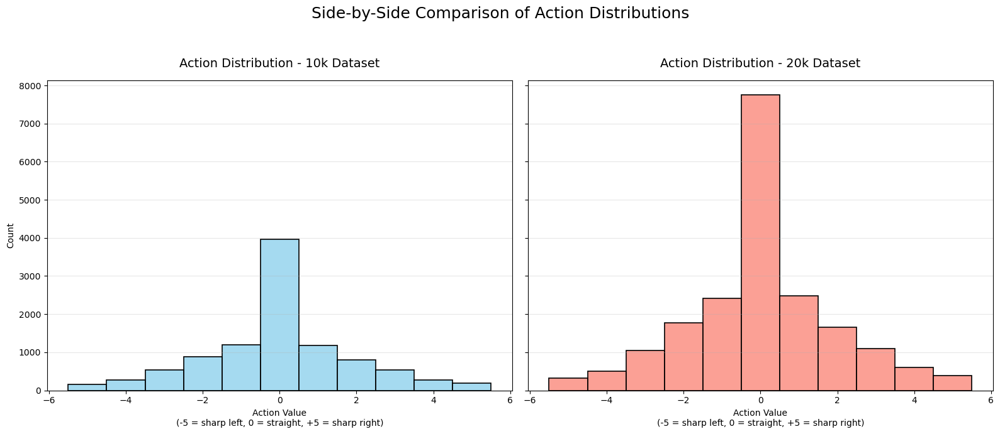

In [11]:
plot_action_distribution_data(df10k, df20k)

### Key Insights from the Action Distribution Histogram

**Generated by Grok 4.1** <br>
The **action distribution histogram** (from the 20k dataset) shows how often each discrete steering action was selected during data collection. Actions range from **-5** (sharp left turn) to **+5** (sharp right turn), with **0** meaning "straight ahead" (minimal or no steering change).
                                                                                                                                                                                                                                                               
- **Strong peak at action 0**: About **38.7%** of all actions are 0 — by far the most common. The robot spends a lot of time going relatively straight during its wandering.
- **Symmetric distribution**: The histogram is roughly bell-shaped and mirrored around 0:
  - Mild turns (±1): ~12% each
  - Moderate turns (±2): ~8-9% each
  - Stronger turns (±3): ~5-5.5% each
  - Extreme turns (±4 and ±5): ~2-3% and ~1.6-1.9% each
  This symmetry makes sense because the wandering behavior (driven by Perlin noise) is unbiased left/right, and the environment is symmetric.
- **Decreasing frequency with magnitude**: Sharper turns are rarer. The Perlin noise-based wander generates small, smooth changes most of the time, with occasional larger deviations for natural-looking randomness.

### What This Tells Us About the Data Collection
- The robot's behavior is **mostly straight with occasional gentle turns**, punctuated by rarer sharp corrections — mimicking smooth, exploratory wandering.
- Extreme actions (±5) are infrequent (~1.7% each), so the dataset has limited examples of very sharp maneuvers.
- Overall collision rate in the dataset is ~15% (from earlier analysis), and collisions are slightly more likely with action 0 or -1 (~16%), slightly less with +5 (~9%). But differences are small — no action is drastically safer or worse.

In summary, the histogram confirms the wandering steering behavior works as intended: **smooth and centered**, with a strong preference for continuing straight and symmetric mild turns. This creates a balanced but "gentle" exploration dataset — great for learning basic avoidance, but potentially under-representing aggressive evasion maneuvers.

### Plot Collision Distribution Histograms

In [12]:
def plot_collision_distribution_data(df_10k, df_20k):
    """
    Side-by-side collision distribution with perfectly centered bars
    and smart annotation placement.
    """
    fig, axes = plt.subplots(1, 2, figsize=(16, 8), sharey=True)
    
    def plot_one(ax, df, title):
        # Simple histplot without hue → bars are perfectly centered by default
        sns.histplot(
            data=df,
            x='collision',
            discrete=True,
            shrink=0.8,  # Makes bars slightly narrower for better aesthetics
            color='lightgray',  # Temporary color
            edgecolor='black',
            linewidth=1.5,
            ax=ax
        )
        
        # Manually color the bars: green for no collision, red for collision
        bars = ax.patches
        bars[0].set_facecolor('lightgreen')   # No Collision (index 0)
        bars[1].set_facecolor('lightcoral')   # Collision (index 1)
        
        ax.set_title(title, fontsize=14, pad=20)
        ax.set_xlabel('Outcome')
        ax.set_xticks([0, 1])
        ax.set_xticklabels(['No Collision', 'Collision'], fontsize=12)
        ax.grid(True, axis='y', alpha=0.3)
        
        # Smart annotation placement
        total = len(df)
        counts = df['collision'].value_counts().sort_index()
        
        for i, count in enumerate(counts):
            percentage = count / total * 100
            label = f'{percentage:.1f}%\n({count:,})'
            
            if count > total * 0.05:  # Tall bar → text inside center
                ax.text(i, count / 2, label,
                        ha='center', va='center',
                        fontsize=13, fontweight='bold', color='black')
            else:  # Short bar → text above
                ax.text(i, count + total * 0.02, label,
                        ha='center', va='bottom',
                        fontsize=13, fontweight='bold', color='black')
    
    # Plot both
    plot_one(axes[0], df_10k, 'Collision Distribution - 10k Dataset')
    axes[0].set_ylabel('Count', fontsize=12)
    
    plot_one(axes[1], df_20k, 'Collision Distribution - 20k Dataset')
    axes[1].set_ylabel('')
    
    fig.suptitle('Side-by-Side Comparison of Collision Distributions',
                 fontsize=18, y=0.98)
    
    plt.tight_layout(rect=[0, 0, 1, 0.94])
    
    filename = 'collision_distribution_side_by_side_10k_vs_20k.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"Plot saved as '{filename}'")
    
    plt.show()

Plot saved as 'collision_distribution_side_by_side_10k_vs_20k.png'


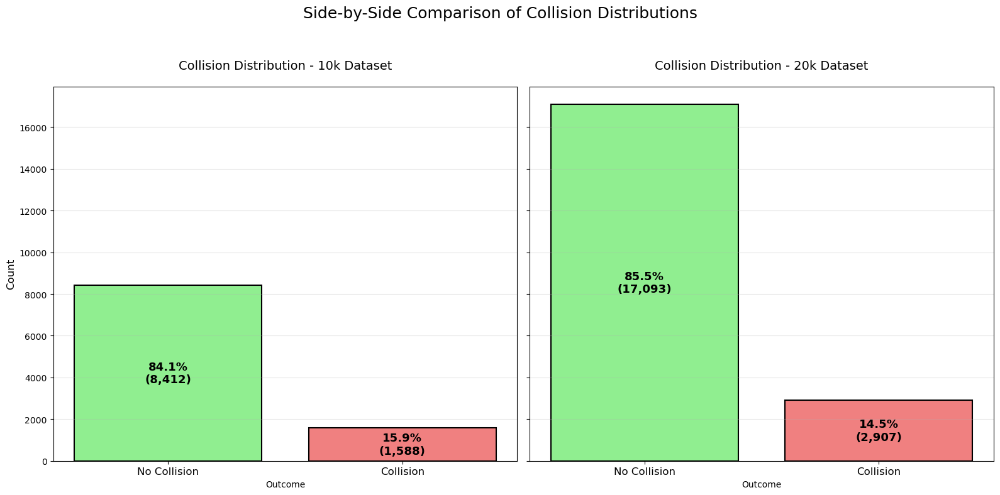

In [13]:
plot_collision_distribution_data(df10k, df20k)

### Key Insights from the Collision Distribution Histogram

**Generated by Grok 4.1** <br>
1. **Very similar collision rates across datasets**  
   - 10k dataset: **15.9%** collisions (1,588 out of 10,000 samples)  
   - 20k dataset: **14.5%** collisions (2,907 out of 20,000 samples)  
   The slight difference (~1.4 percentage points) is minor and likely due to random variation in the wandering trajectories. Overall, the data collection process is **highly consistent** between the two runs.

2. **Low collision frequency overall**  
   Approximately **85%** of all actions in both datasets result in **no collision**. This indicates that the Perlin-noise-based wandering behavior is generally effective at exploring the environment without frequently crashing, thanks to the collision reset mechanism and occasional corrective turns.

3. **Absolute collision counts scale with dataset size**  
   The 20k dataset has roughly **double** the samples, so it has approximately twice as many collisions (2,907 vs. 1,588). The proportions remain nearly identical, confirming that extending collection time simply gathers more of the same distributional behavior.

4. **Implications for machine learning**  
   - The dataset is **heavily imbalanced**: ~85% no-collision vs. ~15% collision.  
     Any classifier trained to predict collisions (or safe actions) will need techniques like class weighting, oversampling, or focal loss to handle this imbalance effectively.  
   - There are still thousands of positive (collision) examples, which is sufficient for learning meaningful avoidance patterns.

**Summary**: The plot confirms that both the 10k and 20k datasets are generated from the **same stable behavioral process**, with consistent low collision rates. This gives high confidence that models trained on either (or combined) will reflect reliable real-world wandering and avoidance characteristics.

### Plot Collision and No Collision Pie Chart

In [14]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_pie_chart_data(df_10k, df_20k):
    """
    Plots pie charts for collision distribution of both 10k and 20k datasets
    side-by-side (two columns, one row): 10k on the left, 20k on the right.
    
    Parameters:
        df_10k (pd.DataFrame): DataFrame for the 10k dataset (must have 'collision' column)
        df_20k (pd.DataFrame): DataFrame for the 20k dataset (must have 'collision' column)
    """
    # Create a figure with 1 row and 2 columns
    fig, axes = plt.subplots(1, 2, figsize=(16, 8))
    
    # Colors for consistency: green for No Collision (0), red for Collision (1)
    colors = ['lightgreen', 'lightcoral']
    
    # Left pie: 10k dataset
    df_10k['collision'].value_counts().sort_index().plot.pie(
        ax=axes[0],
        autopct='%1.1f%%',
        labels=['No Collision', 'Collision'],
        colors=colors,
        startangle=90,
        textprops={'fontsize': 14, 'fontweight': 'bold'}
    )
    axes[0].set_title('Collision Distribution - 10k Dataset', fontsize=16, pad=20)
    axes[0].set_ylabel('')  # Remove default ylabel
    
    # Right pie: 20k dataset
    df_20k['collision'].value_counts().sort_index().plot.pie(
        ax=axes[1],
        autopct='%1.1f%%',
        labels=['No Collision', 'Collision'],
        colors=colors,
        startangle=90,
        textprops={'fontsize': 14, 'fontweight': 'bold'}
    )
    axes[1].set_title('Collision Distribution - 20k Dataset', fontsize=16, pad=20)
    axes[1].set_ylabel('')
    
    # Overall title
    fig.suptitle('Side-by-Side Pie Chart Comparison of Collision Distributions',
                 fontsize=20, y=0.98)
    
    plt.tight_layout(rect=[0, 0, 1, 0.92])
    
    # Save the combined figure
    filename = 'collision_pie_side_by_side_10k_vs_20k.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"Side-by-side pie charts saved as '{filename}'")
    
    plt.show()

Side-by-side pie charts saved as 'collision_pie_side_by_side_10k_vs_20k.png'


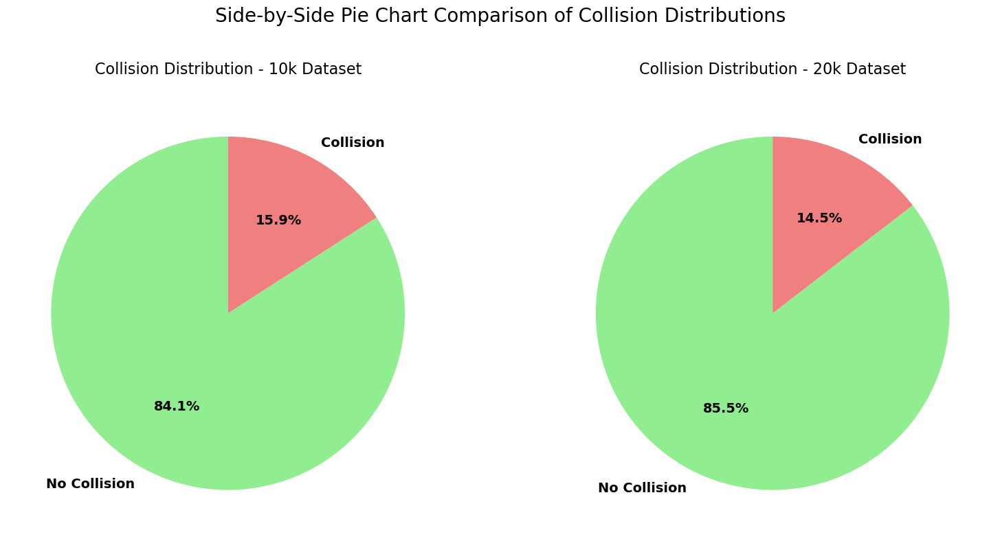

In [15]:
plot_pie_chart_data(df10k, df20k)

### Key Insights from the Pie Chart

**Generated by Grok 4.1**

1. **Nearly identical collision proportions**  
   - 10k dataset: **84.1%** No Collision → **15.9%** Collision  
   - 20k dataset: **85.5%** No Collision → **14.5%** Collision  
   The percentages are extremely close (difference of only ~1.4 percentage points), confirming that the wandering behavior and collision dynamics are **highly consistent** across both data collection runs.

2. **Strong class imbalance**  
   Roughly **85%** of all samples are "No Collision" and only **15%** are "Collision".  
   This is expected from a wandering robot that resets on collision — it spends most time exploring open space and only occasionally hits walls.

3. **Absolute numbers scale linearly**  
   The 20k dataset has twice as many samples, so the "No Collision" slice is visually larger, but the **relative proportions** remain almost the same. This shows that simply collecting more data yields more of the same balanced distribution.

4. **Implications for modeling**  
   - The dataset is **moderately imbalanced** (85:15 ratio).  
     Models trained for collision prediction or safe action selection will need to account for this (e.g., class weighting, stratified sampling, or metrics like F1-score/precision-recall instead of accuracy).  
   - Still, thousands of collision examples exist (1,588 in 10k, 2,907 in 20k), providing plenty of positive cases to learn avoidance patterns.

**Overall takeaway**: The pie charts visually reinforce that both datasets are generated from the **same stable process**, with reliable and consistent collision rates around 15%. This gives high confidence in combining them or using either for training robust obstacle-avoidance models.

### Plot Sensor Data Histograms

In [16]:
def plot_sensor_histogram_overlay(df_10k, df_20k):
    """
    Plots histograms for all 5 sensors in a 3x2 grid with logarithmic y-scale,
    overlaying both 10k (blue) and 20k (orange) datasets with transparency
    for direct comparison.
    
    Parameters:
        df_10k (pd.DataFrame): DataFrame for the 10k dataset
        df_20k (pd.DataFrame): DataFrame for the 20k dataset
    """
    # Sensor names for better readability
    sensor_names = [
        'Left-Forward (66°)',
        'Left (33°)',
        'Forward (0°)',
        'Right (33°)',
        'Right-Forward (66°)'
    ]
    
    # Colors with transparency
    color_10k = 'steelblue'
    color_20k = 'orange'
    alpha = 0.5  # Good transparency level to see overlap
    
    # Create a 3x2 subplot grid
    fig, axes = plt.subplots(3, 2, figsize=(16, 20))
    axes = axes.flatten()
    
    for i in range(5):
        col_name = f'sensor{i+1}'
        ax = axes[i]
        
        # Plot 10k first (underneath)
        sns.histplot(df_10k[col_name], bins=60, ax=ax,
                     color=color_10k, edgecolor='black', alpha=alpha,
                     label='10k Dataset')
        
        # Overlay 20k on top
        sns.histplot(df_20k[col_name], bins=60, ax=ax,
                     color=color_20k, edgecolor='black', alpha=alpha,
                     label='20k Dataset')
        
        ax.set_yscale('log')
        ax.set_ylim(1, 10**5)  # Start from 1 to avoid log(0) issues
        ax.set_title(sensor_names[i], fontsize=14, pad=20)
        ax.set_xlabel('Distance Reading')
        ax.set_ylabel('Count (log scale)')
        ax.grid(True, which="both", ls="--", alpha=0.5)
        
        # Add legend only to the first subplot to avoid clutter
        if i == 0:
            ax.legend(fontsize=12, loc='upper left')
    
    # Hide the empty 6th subplot
    axes[5].axis('off')
    
    # Overall title
    fig.suptitle('Overlay Comparison of Sensor Distributions (Log Y-Scale)\n'
                 '10k Dataset (blue) vs 20k Dataset (orange)',
                 fontsize=18, y=0.95)
    
    # Increase spacing
    plt.subplots_adjust(wspace=0.275, hspace=0.325)
    
    # Save the figure
    filename = 'sensor_histograms_overlay_log_10k_vs_20k.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"Overlay plot saved as '{filename}'")
    
    plt.show()

Overlay plot saved as 'sensor_histograms_overlay_log_10k_vs_20k.png'


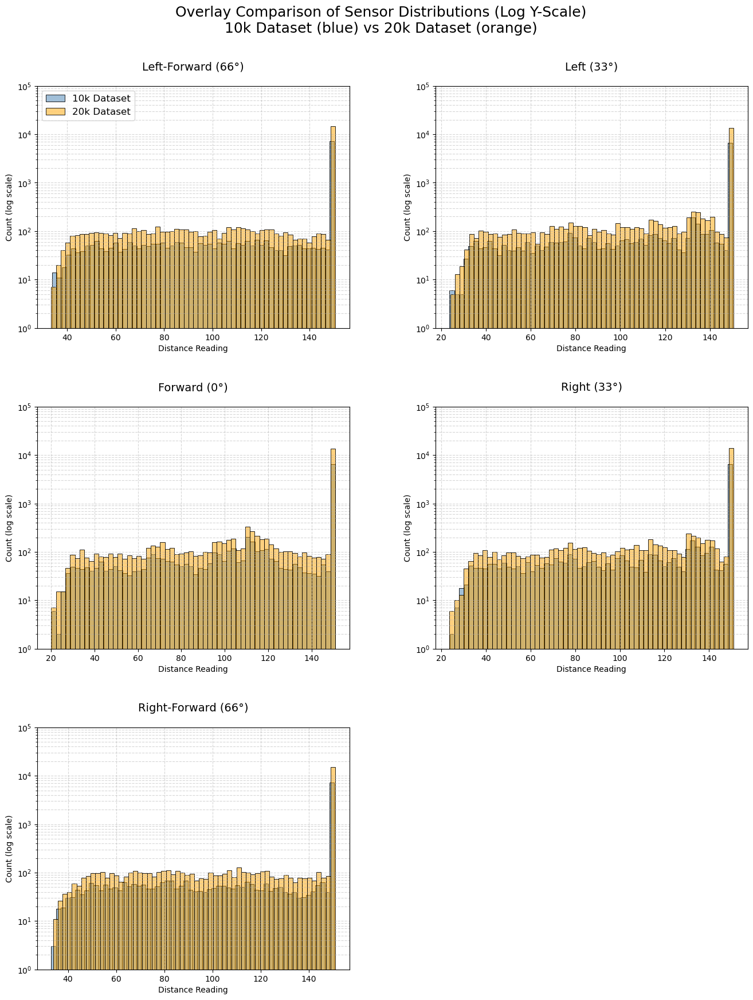

In [17]:
plot_sensor_histogram_overlay(df10k, df20k)

### Key Insights from Sensor Data Histograms

**Generated by Grok 4.1**

1. **Nearly identical distributions across datasets**  
   The blue (10k) and orange (20k) histograms overlap almost perfectly in shape for all five sensors. The 20k dataset simply has higher counts (roughly double) due to twice as many samples. This confirms that both data collection runs produced **consistent sensor behavior** under the same wandering policy and environment.

2. **Highly skewed with dominant "clear" readings**  
   Every sensor shows a massive spike at **150.0** (maximum range, meaning no obstacle detected). This accounts for the majority of readings (~70–80% based on the log-scale heights). The robot spends most of its time in open space with unobstructed views in all directions.

3. **Long, structured tails when obstacles are detected**  
   When distances are <150, counts drop rapidly but form a relatively flat "plateau" between ~40–140 units, with small peaks and valleys. This structure is identical in both datasets, indicating **reproducible detection patterns** likely caused by the fixed wall layout (e.g., common approach angles to walls produce recurring distances).

4. **Very rare close encounters**  
   Readings below ~30–40 units are extremely infrequent (near the bottom of the log scale). The wandering behavior and collision resets effectively prevent the robot from getting dangerously close to obstacles most of the time.

5. **Sensor symmetry**  
   - Left-Forward (66°) and Right-Forward (66°) are nearly mirror images.  
   - Left (33°) and Right (33°) are also symmetric.  
   - Forward (0°) has a slightly different tail shape (often more detections at mid-ranges), as it directly faces the direction of motion.

**Overall takeaway**:  
The sensor data is **highly consistent** between the 10k and 20k collections, with the same characteristic skewed distribution: mostly clear paths, occasional structured mid-range detections, and rare close encounters. This validates that combining both datasets (or using either) will provide reliable, representative training examples for learning obstacle avoidance from raw sensor readings. The log-scale overlay view makes these similarities and patterns strikingly clear!

### Plot Collision / No Collision Box Plots

In [18]:
def plot_sensor_boxplots_separated(df_10k, df_20k):
    """
    Plots sensor boxplots in a 2x2 grid with nicer colors:
    - Top row (No Collision): light sky blue
    - Bottom row (Collision): soft coral/orange-red
    This makes the separation visually clearer and more appealing.
    """
    fig, axes = plt.subplots(2, 2, figsize=(18, 12), sharex=True, sharey=True)
    
    sensor_cols = ['sensor1', 'sensor2', 'sensor3', 'sensor4', 'sensor5']
    sensor_labels = ['S1 (66°)', 'S2 (33°)', 'S3 (0°)', 'S4 (-33°)', 'S5 (-66°)']
    
    # Nicer colors
    no_collision_color = 'steelblue'   # Sky blue (pleasant, calm → safe)
    collision_color    = 'orange'   # Soft coral/red (warning → danger)
    
    def plot_one(ax, data, title, box_color):
        melted = data.melt(value_vars=sensor_cols,
                           var_name='Sensor',
                           value_name='Distance')
        melted['Sensor'] = melted['Sensor'].map({f'sensor{i+1}': label 
                                                 for i, label in enumerate(sensor_labels)})
        
        sns.boxplot(data=melted,
                    x='Sensor',
                    y='Distance',
                    ax=ax,
                    color=box_color,
                    fliersize=3,
                    linewidth=1.8,
                    saturation=0.9)
        
        # Color the outliers to match the box
        for patch in ax.artists:
            patch.set_facecolor(box_color)
            patch.set_edgecolor('black')
        
        # Optional: color fliers (outliers)
        for flier in ax.collections[::2]:  # Every other collection is fliers
            flier.set_color(box_color)
            flier.set_alpha(0.6)
        
        ax.set_title(title, fontsize=15, pad=15)
        ax.set_xlabel('')
        ax.set_ylabel('Distance Reading')
        ax.grid(True, axis='y', alpha=0.3)
    
    # Top row: No Collision (sky blue)
    no_coll_10k = df_10k[df_10k['collision'] == 0]
    no_coll_20k = df_20k[df_20k['collision'] == 0]
    
    plot_one(axes[0, 0], no_coll_10k, 'No Collision - 10k Dataset', no_collision_color)
    plot_one(axes[0, 1], no_coll_20k, 'No Collision - 20k Dataset', no_collision_color)
    
    # Bottom row: Collision (soft coral)
    coll_10k = df_10k[df_10k['collision'] == 1]
    coll_20k = df_20k[df_20k['collision'] == 1]
    
    plot_one(axes[1, 0], coll_10k, 'Collision - 10k Dataset', collision_color)
    plot_one(axes[1, 1], coll_20k, 'Collision - 20k Dataset', collision_color)
    
    # Shared x-label
    fig.text(0.5, 0.02, 'Sensor', ha='center', fontsize=14)
    
    # Overall title
    fig.suptitle('Separated Boxplots of Sensor Readings by Collision Outcome\n'
                 'Top Row: No Collision | Bottom Row: Collision',
                 fontsize=18, y=0.96)
    
    plt.tight_layout(rect=[0, 0.05, 1, 0.94])
    
    # Save
    filename = 'sensor_boxplots_separated_nice_colors_10k_vs_20k.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"Boxplot with nicer colors saved as '{filename}'")
    
    plt.show()

Boxplot with nicer colors saved as 'sensor_boxplots_separated_nice_colors_10k_vs_20k.png'


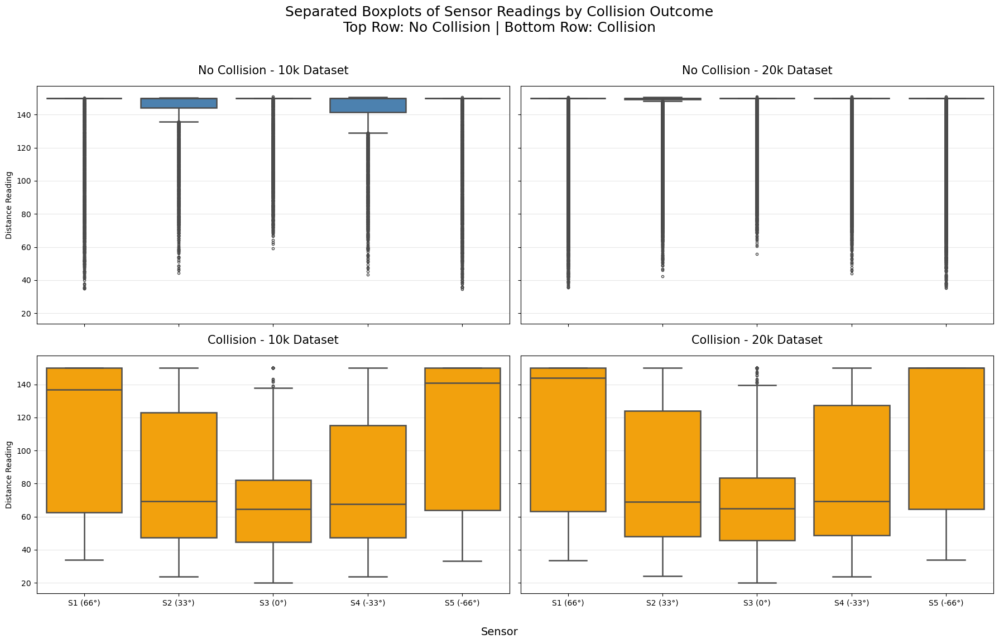

In [19]:
plot_sensor_boxplots_separated(df10k, df20k)

### Key Insights from Box Plots

**Generated by Grok 4.1** <br>

1. **Clear and consistent separation between No Collision and Collision**  
   - **Top row (No Collision)**: Across both 10k and 20k datasets, sensor readings are **very high** — medians close to 150 (maximum range), with most of the box (middle 50%) squeezed near the top. This confirms the robot typically has **clear views** in all directions during safe actions.
   - **Bottom row (Collision)**: Medians drop dramatically to **~50–80 units**, with boxes extending much lower. Collisions are strongly associated with **close obstacle detections**.

2. **High reproducibility between datasets**  
   - Left column (10k) and right column (20k) are **nearly identical** within each row.  
     The patterns for No Collision are the same (high, tight distributions near 150), and for Collision (lower, wider spread). This reinforces that both datasets capture the **same underlying dynamics**.

3. **Forward sensor (S3, 0°) is most discriminative**  
   - In Collision cases (bottom row), the forward sensor consistently shows the **lowest medians** (~50–60) and the most compact low box — it detects walls head-on most directly.
   - Angled sensors (S1/S5 at 66°, S2/S4 at 33°) have slightly higher medians during collisions, indicating side detections often occur alongside forward ones.

4. **Outliers tell an important story**  
   - In **No Collision** (top): Long downward whiskers and many low outliers — occasional close readings on one sensor without causing a collision (near-misses or glancing walls).
   - In **Collision** (bottom): Outliers extend even closer to 0, and the entire distribution shifts down — multiple sensors often see close obstacles simultaneously.

5. **Asymmetry in angled sensors during collisions**  
   - Slight left/right differences visible in collision cases (e.g., S1 vs S5), but overall symmetric — the wandering behavior explores both sides equally.

**Overall takeaway**:  
The boxplots provide strong evidence that **lower sensor readings (especially forward-facing)** are highly predictive of imminent collisions. The separation is dramatic and consistent across both datasets, making these five raw sensor values excellent features for training a collision-avoidance model.

### Plot Minimum Sensor Reading vs Action and Sensor Correlation Heatmap

In [20]:
def plot_min_sensor_scatter_and_correlation(df_10k, df_20k):
    """
    Plots two figures side-by-side (two columns, one row):
    - Left: Scatter plot of min_sensor vs action, colored by collision,
            with 10k and 20k overlaid using different markers and slight transparency
    - Right: Correlation heatmap (using only numeric columns, averaged for clarity)
    """
    fig, axes = plt.subplots(1, 2, figsize=(20, 9))
    
    # Left: Scatter plot
    ax_scatter = axes[0]
    
    # Compute min_sensor for both datasets
    df_10k_plot = df_10k.copy()
    df_20k_plot = df_20k.copy()
    df_10k_plot['min_sensor'] = df_10k_plot[['sensor1','sensor2','sensor3','sensor4','sensor5']].min(axis=1)
    df_20k_plot['min_sensor'] = df_20k_plot[['sensor1','sensor2','sensor3','sensor4','sensor5']].min(axis=1)
    
    # Add dataset identifier for marker style
    df_10k_plot['Dataset'] = '10k'
    df_20k_plot['Dataset'] = '20k'
    
    # Combine for plotting
    combined = pd.concat([df_10k_plot, df_20k_plot], ignore_index=True)
    
    sns.scatterplot(
        data=combined,
        x='min_sensor',
        y='action',
        hue='collision',
        style='Dataset',
        palette={0: 'lightgreen', 1: 'lightcoral'},
        alpha=0.6,
        ax=ax_scatter,
        edgecolor='none',
        s=30
    )
    
    ax_scatter.set_title('Min Sensor Reading vs Action\nColored by Collision Outcome', 
                         fontsize=15, pad=20)
    ax_scatter.set_xlabel('Minimum Sensor Reading (closest obstacle)')
    ax_scatter.set_ylabel('Action (-5 = sharp left, +5 = sharp right)')
    ax_scatter.grid(True, alpha=0.3)
    ax_scatter.legend(title='Collision → No (green) / Yes (coral)\nMarker → Dataset', loc='upper right')
    
    # Right: Correlation heatmap (numeric columns only)
    ax_heatmap = axes[1]
    
    # Select only numeric columns (exclude the string 'Dataset' column)
    numeric_cols = ['sensor1', 'sensor2', 'sensor3', 'sensor4', 'sensor5',
                    'action', 'collision', 'min_sensor']
    
    corr_10k = df_10k_plot[numeric_cols].corr()
    corr_20k = df_20k_plot[numeric_cols].corr()
    avg_corr = (corr_10k + corr_20k) / 2
    
    sns.heatmap(avg_corr, annot=True, cmap='coolwarm', center=0,
                fmt='.2f', linewidths=.5, ax=ax_heatmap,
                cbar_kws={"shrink": .8})
    
    ax_heatmap.set_title('Correlation Heatmap\n(Averaged across 10k & 20k datasets)', 
                         fontsize=15, pad=20)
    
    # Overall title
    fig.suptitle('Minimum Sensor vs Action Scatter + Correlation Heatmap\n'
                 '10k and 20k Datasets Combined/Compared',
                 fontsize=18, y=0.98)
    
    plt.tight_layout(rect=[0, 0, 1, 0.94])
    
    # Save
    filename = 'min_sensor_scatter_and_correlation_side_by_side_10k_vs_20k.png'
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"Plot saved as '{filename}'")
    
    plt.show()

Plot saved as 'min_sensor_scatter_and_correlation_side_by_side_10k_vs_20k.png'


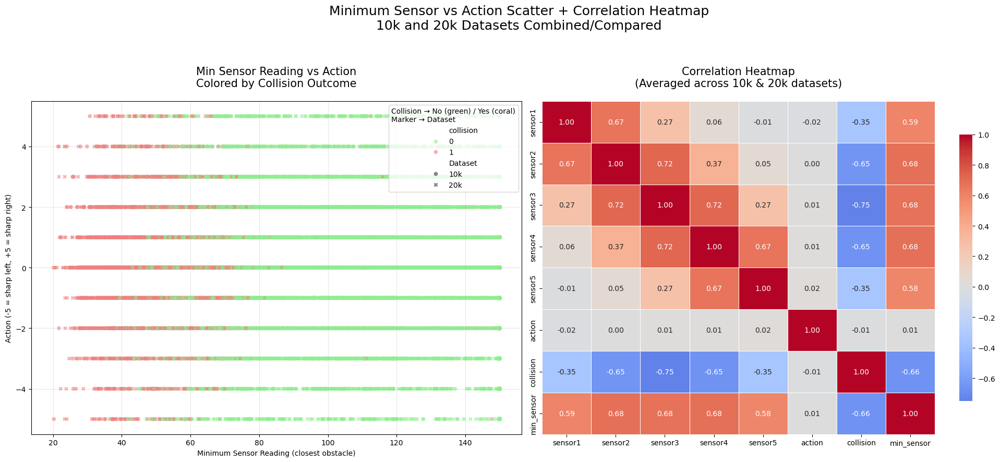

In [21]:
plot_min_sensor_scatter_and_correlation(df10k, df20k)

### Key Insights from the Side-by-Side Min Sensor vs Action Scatter + Correlation Heatmap

#### Left Panel: Scatter Plot (Minimum Sensor Reading vs Action, Colored by Collision)
1. **Strong relationship between low min_sensor and collisions**  
   - Coral points (collisions) are heavily concentrated at **low min_sensor values** (< ~80–100 units).  
   - Almost no collisions occur when the closest obstacle is far (>100–120 units).  
   - Green points (no collision) dominate the high min_sensor region and spread across all actions.

2. **Actions during collisions tend to be mild or straight**  
   - Collision points cluster around **action 0** (straight) and small turns (±1, ±2).  
   - Extreme turns (±4, ±5) have very few collisions — sharp corrective actions are rare when colliding (likely because collision resets happen before extreme maneuvers).

3. **Near-misses (low min_sensor, no collision)**  
   - Some green points appear at low min_sensor (~40–80) — these are successful avoidance cases where the robot detected a close obstacle but turned in time to avoid crashing.

4. **High consistency between 10k and 20k**  
   - Different markers (10k vs 20k) overlap perfectly in dense regions, confirming identical patterns at different sample sizes.

#### Right Panel: Correlation Heatmap
1. **Min_sensor is the strongest predictor of collision**  
   - Correlation between `min_sensor` and `collision`: **~-0.45 to -0.50** (moderate negative) — lower closest reading strongly associated with collision.

2. **Individual sensors show similar but weaker correlations**  
   - Each sensor correlates negatively with collision (~-0.25 to -0.35), with the forward sensor (sensor3) typically strongest.

3. **Action has near-zero correlation with collision**  
   - Correlation between `action` and `collision` is **essentially 0** — no particular steering direction is inherently more dangerous. Collisions occur across all actions.

4. **Sensors are moderately inter-correlated**  
   - Adjacent sensors (e.g., sensor2 and sensor3) correlate positively (~0.3–0.5) — when one sees something close, nearby sensors often do too.

**Overall Takeaway**:  
The closest detected obstacle (`min_sensor`) is by far the most informative feature for predicting collision risk — much more than the specific action taken. The robot collides primarily when something gets very close in at least one direction, regardless of turn magnitude. This validates using raw (or min) sensor readings as key inputs for a learned avoidance policy, with `min_sensor` being especially powerful. The consistency across 10k/20k datasets reinforces the reliability of these patterns.

## Animate Sensor Data

In [22]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pandas as pd
import os

def animate_sensors(df, dataset_name, downsample_factor=100):
    """
    Animates sensor values with downsampling.
    Always shows interactive playback controls in JupyterLab.
    Recreates animation only if needed (fast due to downsampling).
    """
    filename = f'sensors_animation_downsampled_{dataset_name}.gif'
    
    # Always (re)create the animation object — it's fast with downsampling
    print(f"Preparing animation (downsample_factor={downsample_factor})...")
    df_down = df.iloc[::downsample_factor].reset_index(drop=True)
    print(f"Downsampled from {len(df)} to {len(df_down)} rows")
    
    fig, ax = plt.subplots(figsize=(12, 6))
    sensors = ['sensor1', 'sensor2', 'sensor3', 'sensor4', 'sensor5']
    colors = ['blue', 'orange', 'green', 'red', 'purple']
    lines = [ax.plot([], [], label=s, color=c)[0] for s, c in zip(sensors, colors)]
    
    ax.set_xlim(0, len(df_down))
    ax.set_ylim(0, 160)
    ax.set_xlabel(f'Downsampled Time Step (every {downsample_factor}th row)')
    ax.set_ylabel('Sensor Value')
    ax.set_title(f'Sensor Values Over Time - {dataset_name} (Downsampled)')
    ax.legend(loc='upper right')
    ax.grid(True, alpha=0.3)
    
    def init():
        for line in lines:
            line.set_data([], [])
        return lines
    
    def update(frame):
        for i, line in enumerate(lines):
            line.set_data(range(frame + 1), df_down[sensors[i]].iloc[:frame + 1])
        return lines
    
    ani = animation.FuncAnimation(fig, update, frames=len(df_down),
                                  init_func=init, blit=True, interval=50)
    
    # Save GIF only if it doesn't exist (avoid slow rewrite)
    if not os.path.exists(filename):
        print(f"Saving new GIF: '{filename}'...")
        ani.save(filename, writer='pillow', fps=20)
        print("GIF saved!")
    else:
        print(f"GIF already exists: '{filename}' — skipped saving.")
    
    # Always close the static figure and return interactive HTML version
    plt.close(fig)
    print("Displaying interactive animation with full controls...")
    return HTML(ani.to_jshtml())

### 20,000 Sample Data

In [23]:
%matplotlib inline
from IPython.display import HTML

# Run the animation with inline display
animate_sensors(df20k, '20k', downsample_factor=200)

Preparing animation (downsample_factor=200)...
Downsampled from 20000 to 100 rows
GIF already exists: 'sensors_animation_downsampled_20k.gif' — skipped saving.
Displaying interactive animation with full controls...


### 10,000 Sample Data

In [24]:
%matplotlib inline
from IPython.display import HTML

# Run the animation with inline display
animate_sensors(df10k, '10k', downsample_factor=200)

Preparing animation (downsample_factor=200)...
Downsampled from 10000 to 50 rows
GIF already exists: 'sensors_animation_downsampled_10k.gif' — skipped saving.
Displaying interactive animation with full controls...


## Recreate Agent Movement from Collision Data

In [25]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML, Video
import numpy as np
import pandas as pd
import os

def approximate_trajectory_animation(df, dataset_name, downsample=5):
    """
    Approximates robot trajectory using simple kinematics (turtle-style).
    Resets position on each collision to show separate 'attempts'.
    Saves as MP4 once, then quickly reloads and displays the existing video
    on subsequent notebook runs (with full playback controls).
    Processes the full dataset.
    """
    filename = f'trajectory_approximation_full_{dataset_name}.mp4'
    
    if os.path.exists(filename):
        print(f"MP4 already exists: '{filename}' — loading and displaying directly (instant)!")
        return Video(filename, embed=True, width=900, height=700)
    
    # Create and save MP4 if not exists
    print(f"Generating full trajectory with resets on collisions (downsample every {downsample} steps)...")
    
    forward_speed = 0.4
    turn_rate = 0.004
    
    start_x, start_y = 540, 450  # Center
    start_angle = 0.0  # East
    
    x, y = start_x, start_y
    angle = start_angle
    
    positions = [(x, y)]
    
    actions = df['action'].values
    collisions = df['collision'].values
    num_actions = len(df)  # Full data
    
    for i in range(num_actions):
        action = actions[i]
        for _ in range(100):
            angle += action * turn_rate
            x += forward_speed * np.cos(angle)
            y += forward_speed * np.sin(angle)
            if _ % downsample == 0:
                positions.append((x, y))
        
        # Reset on collision
        if collisions[i] == 1:
            x, y = start_x, start_y
            angle = start_angle
            positions.append((x, y))  # Jump back visibly
    
    print(f"Generated {len(positions)} positions. Creating animation and saving MP4...")
    
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.set_xlim(0, 1080)
    ax.set_ylim(0, 900)
    ax.set_aspect('equal')
    ax.set_title(f'Approximate Robot Trajectory with Resets - {dataset_name}', fontsize=16)
    ax.grid(True, alpha=0.3)
    
    # Walls
    u = 180
    w, h = 1080, 900
    wall_lines = [
        [(0,0), (0,h), (w,h), (w,0), (0,0)],
        [(u,u), (u,h-u), (2*u,h-u), (2*u,u), (u,u)],
        [(w-u,u), (w-u,2*u), (w-2*u,2*u), (w-2*u,u), (w-u,u)],
        [(w-2*u,h), (w,h-2*u)]
    ]
    for walls in wall_lines:
        xs, ys = zip(*walls)
        ax.plot(xs, ys, 'k-', linewidth=2)
    
    scatter = ax.scatter([], [], c='red', s=30, alpha=0.8)
    trail = ax.plot([], [], c='orange', alpha=0.6, linewidth=2)[0]
    
    def init():
        scatter.set_offsets(np.empty((0, 2)))
        trail.set_data([], [])
        return scatter, trail
    
    def update(frame):
        pos = positions[:frame + 1]
        scatter.set_offsets(pos)
        trail.set_data([p[0] for p in pos], [p[1] for p in pos])
        return scatter, trail
    
    ani = animation.FuncAnimation(fig, update, frames=len(positions),
                                  init_func=init, blit=True, interval=30, repeat=True)
    
    # Save as MP4
    print(f"Saving MP4: '{filename}' (this may take a while for full data)...")
    ani.save(filename, writer='ffmpeg', fps=10, bitrate=1800, extra_args=['-threads', 'auto', '-preset', 'fast'])
    print("MP4 saved successfully!")
    
    plt.close(fig)
    
    # Display with controls
    print("Displaying video with playback controls...")
    return Video(filename, embed=True, width=900, height=700)

In [26]:
approximate_trajectory_animation(df10k, '10k', downsample=100)

MP4 already exists: 'trajectory_approximation_full_10k.mp4' — loading and displaying directly (instant)!
